In [1]:
import torch
from torch import nn
from torch.utils.data import DataLoader

import numpy as np 
import pathlib

# Importing utitility functions for training
from PT_files.model import DnCNN, DnCNN_B
from PT_files.Dataset import Img_Dataset, Large_Img_Dataset
import PT_files.preprocess_data as ppd
import PT_files.save_load as sl
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"
# device = "cpu"

Using cuda device


In [2]:
data_6k = sl.NERSC_load('test_data70-6000.npy')
# model = DnCNN()
# param_name = "2k_model_bs64_e200.pth"    
# start_idx = 0
# end_idx = 2000

# samp_idx = 0
# noise_data_2k = data_6k[0]

Function that uses 2k by 2k slices

In [3]:
def grid_window(dataset,
                model,
                model_params,
                samp_idx,
                h_start,
                h_end,
                w_start,
                w_end):
    
    full = np.empty((1, 1, 6000, 6000))
    count = np.empty((1, 1, 6000, 6000))
    
    noise_data = dataset[0]
    params_name = model_params
    
    current_dir = pathlib.Path().resolve()
    model_params_path = current_dir / 'Model_params'
    assert model_params_path.exists()
    model_path = model_params_path / params_name
    
    model = model()
    model.to(device)
    model.load_state_dict(torch.load(str(model_path)))
    model.eval()
    
    with torch.no_grad():
        
        torch.cuda.empty_cache()
        test_noise = torch.as_tensor(noise_data[samp_idx:samp_idx+1, :, h_start:h_end, w_start:w_end])
        test_noise = test_noise.to(device)
        
        output = model(test_noise)
        resid_img = output.cpu().detach().numpy()
        
        full[:, :, h_start:h_end, w_start:w_end] += resid_img
        count[:, :, h_start:h_end, w_start:w_end] += 1
        
    return full, count

In [4]:
full, count = grid_window(dataset=data_6k,
                          model=DnCNN,
                          model_params="2k_model_bs64_e200.pth",
                          samp_idx=0,
                          h_start=0,
                          h_end=2000,
                          w_start=0,
                          w_end=2000)

Text(0.5, 1.0, 'Denoised Sample (2k Model)')

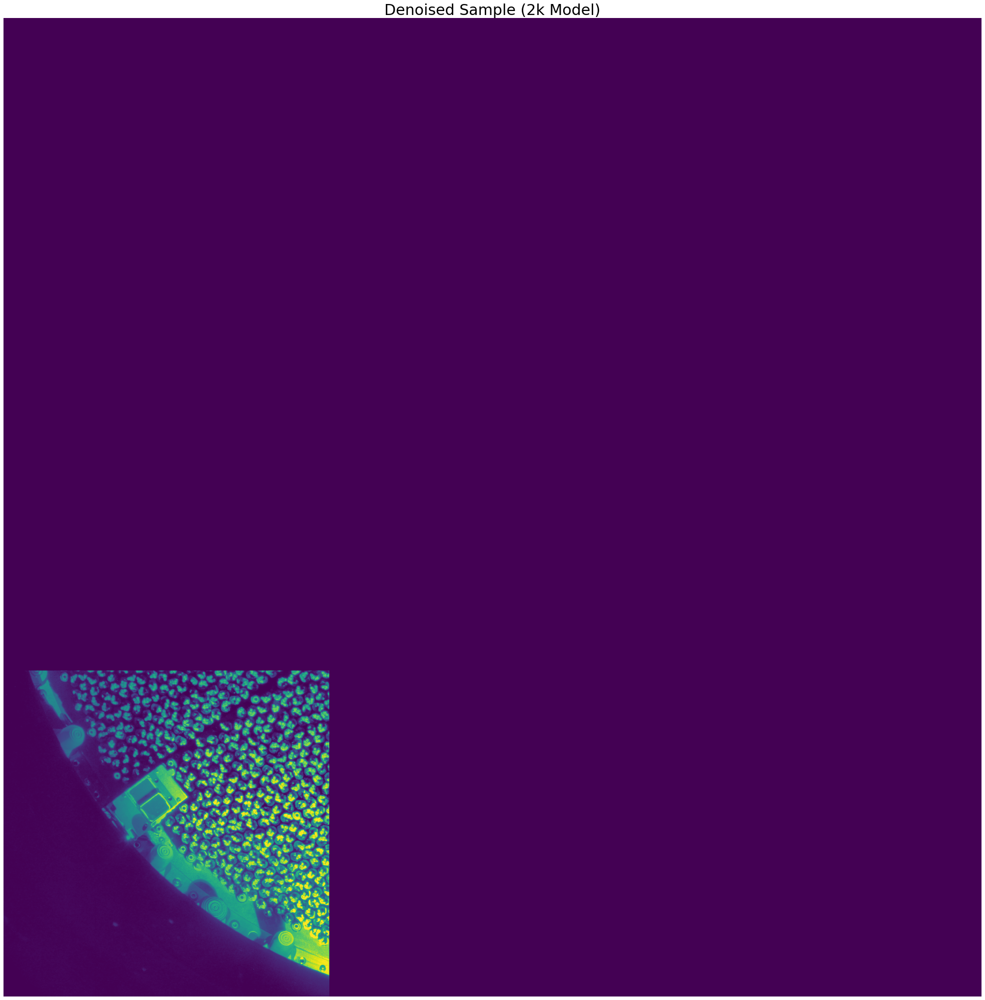

In [5]:
fig, ax = plt.subplots(1, 1, figsize=(40,36))
vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

ax.imshow(full[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax.axis('off')
ax.set_title('Denoised Sample (2k Model)', fontsize=30)

# plt.imsave('Denoised_2k_model.png', full[0][0], vmin=vmin, vmax=vmax, origin='lower')

Text(0.5, 1.0, 'Truth Sample')

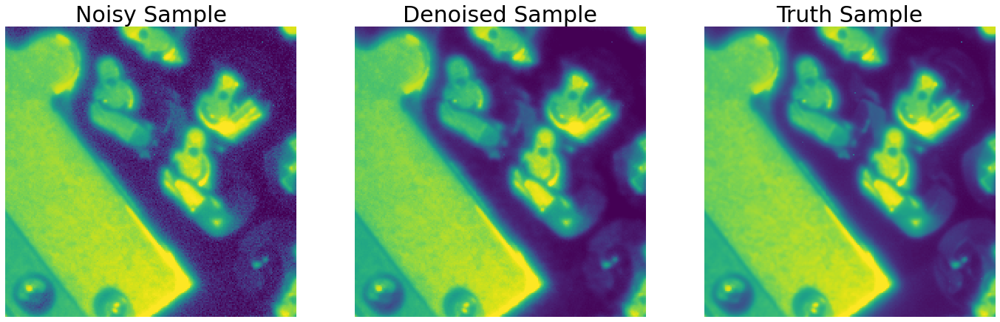

In [6]:
fig, ax = plt.subplots(1, 3, figsize=(24,20))
vmin, vmax = np.percentile(data_6k[0][0][0][1200:1400,1000:1200], (1,99))


ax[0].imshow(data_6k[0][0][0][1200:1400,1000:1200], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax[0].axis('off')
ax[0].set_title('Noisy Sample', fontsize=30)
ax[1].imshow(full[0][0][1200:1400,1000:1200],vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax[1].axis('off')
ax[1].set_title('Denoised Sample', fontsize=30)
ax[2].imshow(data_6k[1][0][0][1200:1400,1000:1200], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax[2].axis('off')
ax[2].set_title('Truth Sample', fontsize=30)

In [7]:
# def full_img_pass(dataset,
#                   model,
#                   model_params,
#                   model_size: int,
#                   samp_idx: int):
    
#     noise_data = dataset[0]
#     params_name = str(model_params)

#     current_dir = pathlib.Path().resolve()
#     model_params_path = current_dir / 'Model_params'
#     assert model_params_path.exists()
#     model_path = model_params_path / params_name
    
    
#     patch_length = model_size
#     num_patch_across = int(len(noise_data[0][0]) / patch_length)
#     patch_end_idxs = []
#     for i in range(patch_length+1):
#         patch_end_idxs.append(patch_length*i)
        
#     for k in range(len(patch_end_idxs)):
#         full, count = grid_window(dataset=dataset,
#                                   model=model,
#                                   model_params=model_params,
#                                   samp_idx=samp_idx,
#                                   h_start=patch_end_idxs[k],
#                                   h_end=patch_end_idxs[k+1],
#                                   w_start=patch_end_idxs[0],
#                                   w_end=patch_end_idxs[1])
    
#     return full, count

In [8]:
# full, count = full_img_pass(dataset=data_6k,
#                             model=DnCNN,
#                             model_params="2k_model_bs64_e200.pth",
#                             model_size=2000,
#                             samp_idx=0)

In [9]:
len(data_6k[0][0][0]) % 2 == 0

True

In [10]:
# patch_length = int(len(data_6k[0][0][0]) / 2000)
# patch_size = 2000
# patch_end_idxs = []
# for i in range(patch_length):
#     patch_end_idxs.append(patch_size*(i+1))
    
# print(patch_end_idxs)

In [11]:
device = "cuda" if torch.cuda.is_available() else "cpu"


In [12]:
# full, count = grid_window(dataset=data_6k,
#                           model=DnCNN,
#                           model_params="2k_model_bs64_e200.pth",
#                           samp_idx=0,
#                           h_start=0,
#                           h_end=patch_end_idxs[0],
#                           w_start=patch_end_idxs[0],
#                           w_end=patch_end_idxs[1])

In [13]:
# for i in range(len(patch_end_idxs)):
#     full, count = grid_window(dataset=data_6k,
#                           model=DnCNN,
#                           model_params="2k_model_bs64_e200.pth",
#                           samp_idx=0,
#                           h_start=0,
#                           h_end=patch_end_idxs[i],
#                           w_start=patch_end_idxs[0],
#                           w_end=patch_end_idxs[1])

In [14]:
# fig, ax = plt.subplots(1, 1, figsize=(40,36))
# vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

# ax.imshow(full[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
# ax.axis('off')
# ax.set_title('Denoised Sample (2k Model)', fontsize=30)

# # plt.imsave('Denoised_2k_model.png', full[0][0], vmin=vmin, vmax=vmax, origin='lower')

In [7]:
patch_length = int(len(data_6k[0][0][0]) / 2000)
patch_size = 2000
window_move_distance = 1000
patch_end_idxs = []
for i in range(patch_length):
    patch_end_idxs.append(patch_size*(i+1))
    
direction_dep_window = list(np.array(patch_end_idxs) - 1000)
print(patch_end_idxs)
print(direction_dep_window)

[2000, 4000, 6000]
[1000, 3000, 5000]


In [9]:
patch_length = int(len(data_6k[0][0][0]) / 2000)
patch_size = 2000
window_move_distance = 1000
patch_end_idxs = []
for i in range(patch_length):
    patch_end_idxs.append(patch_size*(i+1))
    
direction_dep_window = list(np.array(patch_end_idxs) - 1000)
print(patch_end_idxs)
print(direction_dep_window)

vert_pass_end_idxs = []()

[2000, 4000, 6000]
[1000, 3000, 5000]


In [5]:
vert_pass_end_idxs = [(1000, 3000), (3000, 5000)]
full_pass_end_idxs = [(0, 2000), (2000, 4000), (4000, 6000)]
print(vert_pass_end_idxs[0])

(1000, 3000)


Does vertical, horizontal, and full pass. The reason theres two 'left' & 'right' passes per directional pass is because when using tuples as the odd index cuts it only took the 2nd tuple indexs and not the 1st, thus currently hard-coding it in as of right now. Later down in the notebook they are all added together & divided by the count number. Need more generalization/testing because this seems very odd.

Text(0.5, 1.0, 'Denoised Sample (2k Model)')

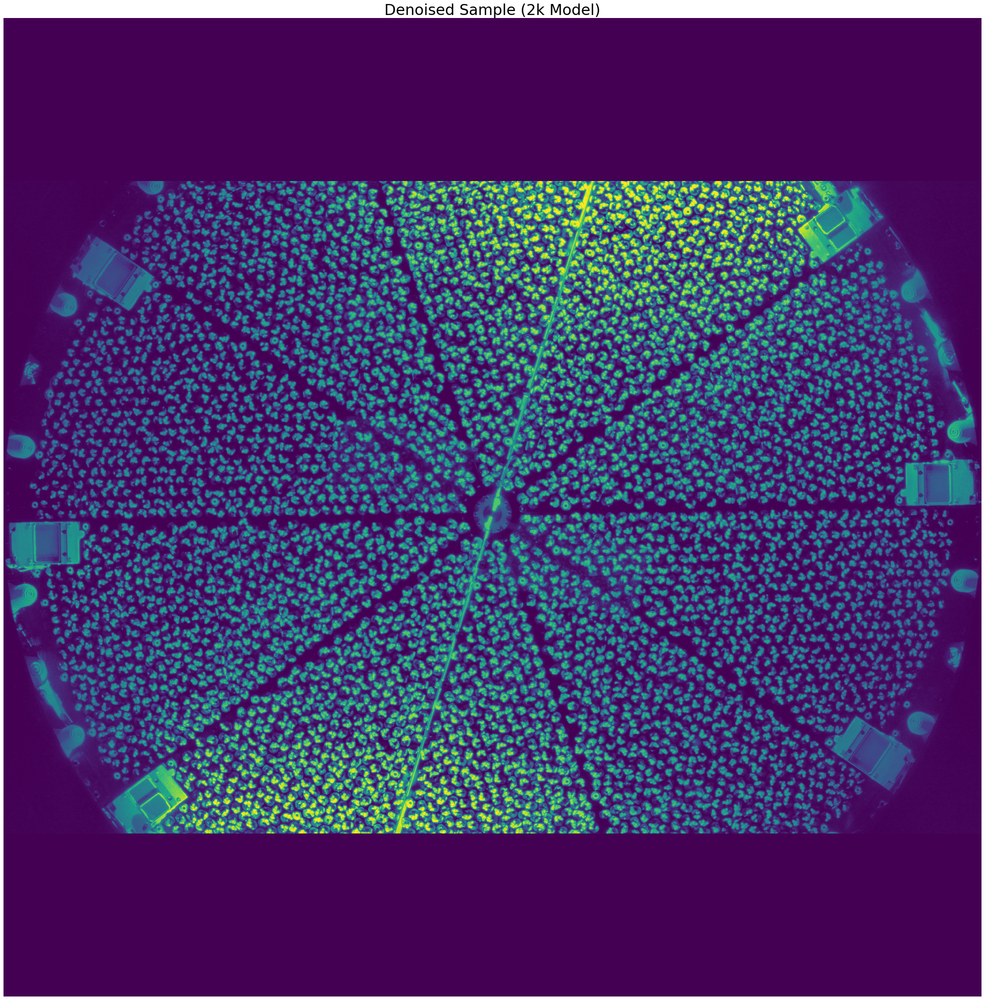

In [17]:
device = "cpu"

# Horizontal pass
for i in range(len(full_pass_end_idxs)):
    for j in range(len(vert_pass_end_idxs)):
        full_h_L, count_h_L = grid_window(dataset=data_6k,
                                  model=DnCNN,
                                  model_params="2k_model_bs64_e200.pth",
                                  samp_idx=0,
                                  h_start=vert_pass_end_idxs[0][0],
                                  h_end=vert_pass_end_idxs[0][1],
                                  w_start=0,
                                  w_end=patch_end_idxs[i])
        
        full_h_R, count_h_R = grid_window(dataset=data_6k,
                                  model=DnCNN,
                                  model_params="2k_model_bs64_e200.pth",
                                  samp_idx=0,
                                  h_start=vert_pass_end_idxs[1][0],
                                  h_end=vert_pass_end_idxs[1][1],
                                  w_start=0,
                                  w_end=patch_end_idxs[i])
        
full_h = full_h_L + full_h_R
count_h = count_h_L + count_h_R
        
fig, ax = plt.subplots(1, 1, figsize=(40,36))
vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

ax.imshow(full_h[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax.axis('off')
ax.set_title('Denoised Sample (2k Model)', fontsize=30)       

Text(0.5, 1.0, 'Denoised Sample (2k Model)')

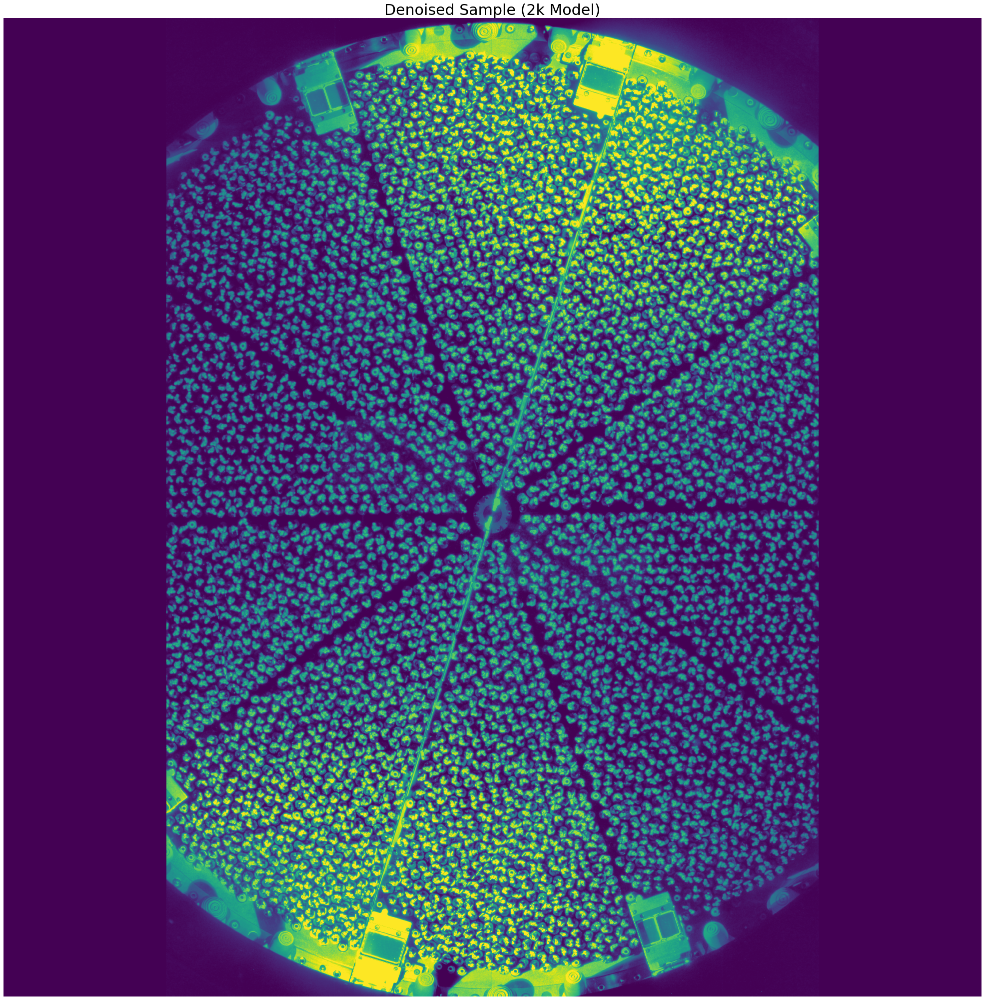

In [18]:
device = "cpu"

# Vertical pass
for i in range(len(full_pass_end_idxs)):
    for j in range(len(vert_pass_end_idxs)):
        full_v_L, count_v_L = grid_window(dataset=data_6k,
                                  model=DnCNN,
                                  model_params="2k_model_bs64_e200.pth",
                                  samp_idx=0,
                                  h_start=0,
                                  h_end=patch_end_idxs[i],
                                  w_start=vert_pass_end_idxs[0][0],
                                  w_end=vert_pass_end_idxs[0][1])
        
        full_v_R, count_v_R = grid_window(dataset=data_6k,
                                  model=DnCNN,
                                  model_params="2k_model_bs64_e200.pth",
                                  samp_idx=0,
                                  h_start=0,
                                  h_end=patch_end_idxs[i],
                                  w_start=vert_pass_end_idxs[1][0],
                                  w_end=vert_pass_end_idxs[1][1])
        
full_v = full_v_L + full_v_R
count_v = count_v_L + count_v_R
        
fig, ax = plt.subplots(1, 1, figsize=(40,36))
vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

ax.imshow(full_v[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax.axis('off')
ax.set_title('Denoised Sample (2k Model)', fontsize=30)       

In [19]:
# device = "cpu"

# # Vertical pass
# for i in range(len(direction_dep_window)):
#     for j in range(len(patch_end_idxs)):
#         full, count = grid_window(dataset=data_6k,
#                                   model=DnCNN,
#                                   model_params="2k_model_bs64_e200.pth",
#                                   samp_idx=0,
#                                   h_start=0,
#                                   h_end=patch_end_idxs[i],
#                                   w_start=0,
#                                   w_end=patch_end_idxs[j]

Text(0.5, 1.0, 'Denoised Sample (2k Model)')

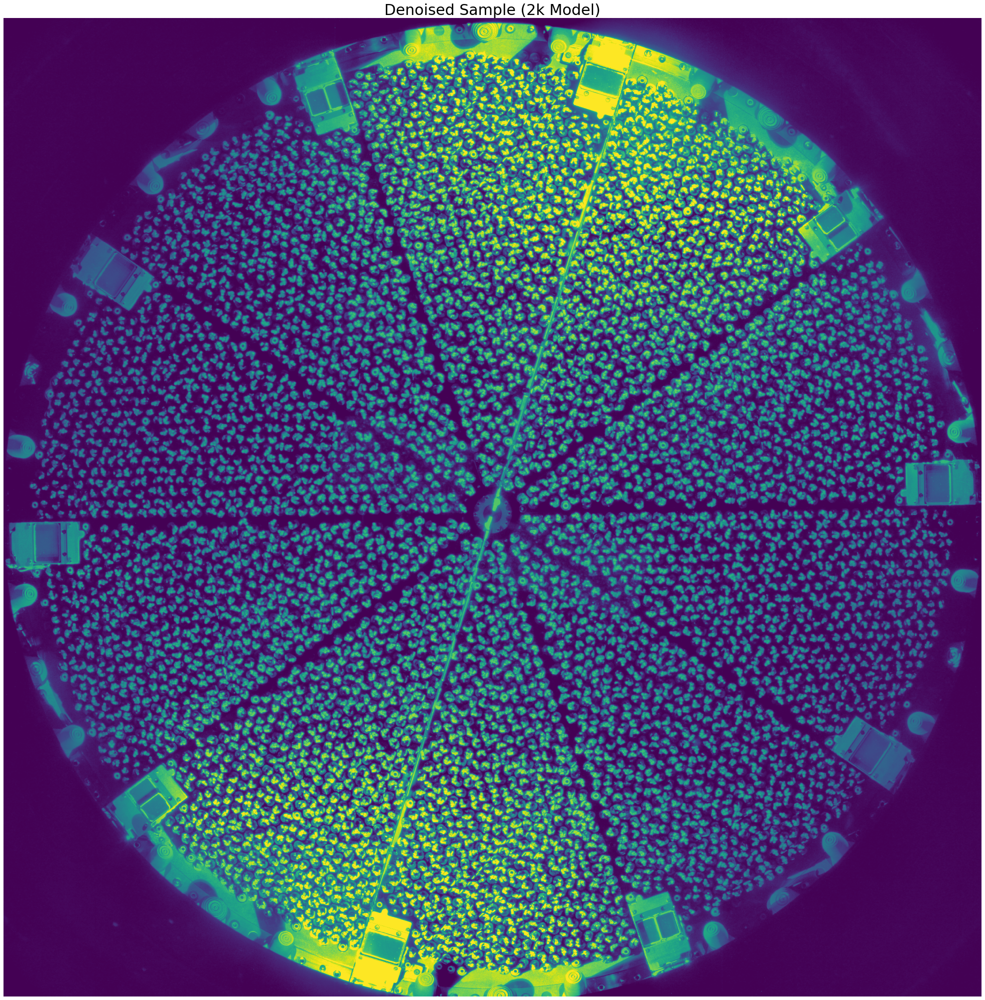

In [20]:
device = "cpu"

# Full image pass
for i in range(len(patch_end_idxs)):
    for j in range(len(patch_end_idxs)):
        full, count = grid_window(dataset=data_6k,
                              model=DnCNN,
                              model_params="2k_model_bs64_e200.pth",
                              samp_idx=0,
                              h_start=0,
                              h_end=patch_end_idxs[i],
                              w_start=0,
                              w_end=patch_end_idxs[j])

    
fig, ax = plt.subplots(1, 1, figsize=(40,36))
vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

ax.imshow(full[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax.axis('off')
ax.set_title('Denoised Sample (2k Model)', fontsize=30)

# plt.imsave('Denoised_2k_model.png', full[0][0], vmin=vmin, vmax=vmax, origin='lower')

Text(0.5, 1.0, 'Denoised Sample (2k Model)')

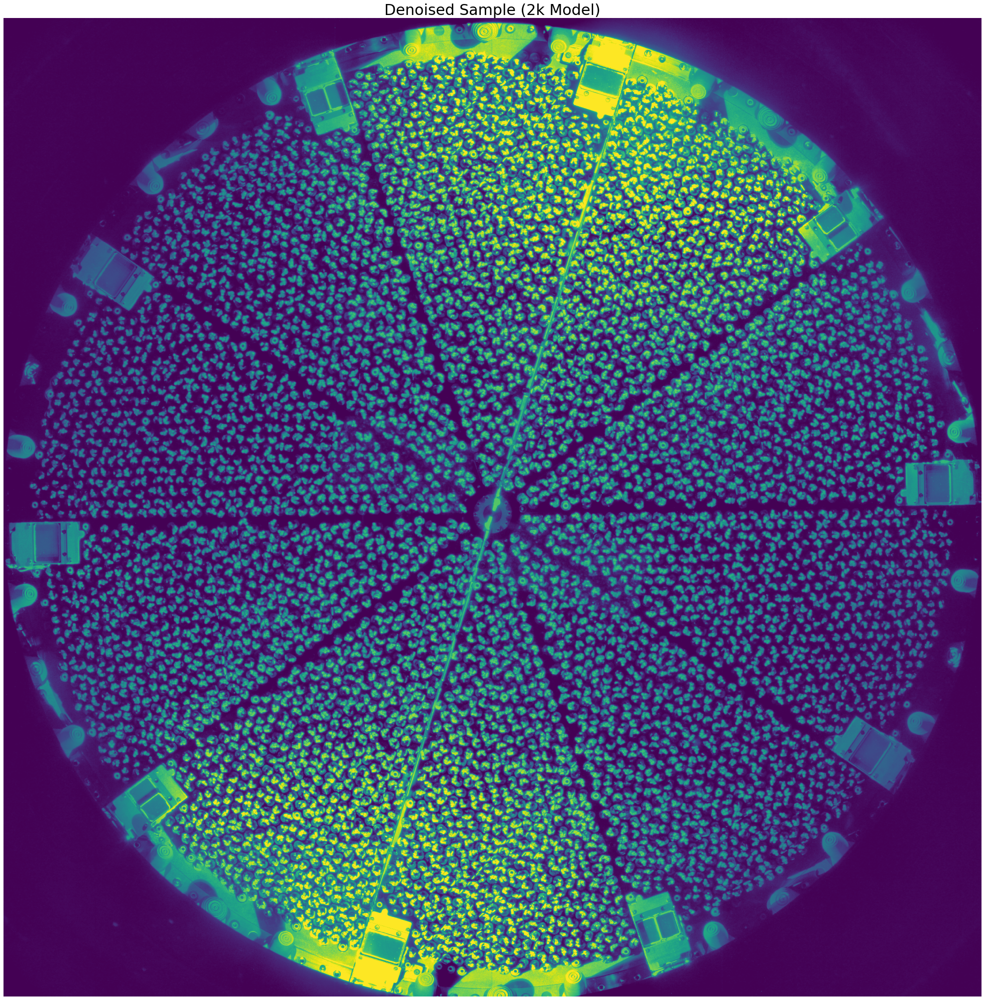

In [21]:
full_tot = full + full_h + full_v
count_tot = count + count_h + count_v

full_avg = full_tot / count_tot

fig, ax = plt.subplots(1, 1, figsize=(40,36))
vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

ax.imshow(full_avg[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
ax.axis('off')
ax.set_title('Denoised Sample (2k Model)', fontsize=30)

In [30]:
sl.NERSC_save(name='2k_afterburner_img',
              data=full_avg)

In [22]:
count_tot[0][0][2000,3000]

3.0

In [23]:
# def full_img_pass(dataset,
#                   model,
#                   model_params,
#                   model_size: int,
#                   samp_idx: int):
    
#     noise_data = dataset[0]    
#     patch_length = model_size
#     num_patch_across = int(len(noise_data[0][0]) / patch_length)
#     patch_end_idxs = []
#     for i in range(patch_length):
#         patch_end_idxs.append(patch_length*(i+1))
        
#     for j in range(len(patch_end_idxs)):
#         for k in range(len(patch_end_idxs)):

#             full, count = grid_window(dataset=dataset,
#                                       model=model,
#                                       model_params=model_params,
#                                       samp_idx=samp_idx,
#                                       h_start=0,
#                                       h_end=patch_end_idxs[j],
#                                       w_start=0,
#                                       w_end=patch_end_idxs[k])
    
#     return full, count

In [24]:
# full, count = full_img_pass(dataset=data_6k,
#                             model=DnCNN,
#                             model_params="2k_model_bs64_e200.pth",
#                             model_size=2000,
#                             samp_idx=0)

In [25]:
# fig, ax = plt.subplots(1, 1, figsize=(40,36))
# vmin, vmax = np.percentile(data_6k[0][0][0], (1,99))

# ax.imshow(full[0][0], vmin=vmin, vmax=vmax, origin='lower', interpolation='none')
# ax.axis('off')
# ax.set_title('Denoised Sample (2k Model)', fontsize=30)

In [26]:
asd

NameError: name 'asd' is not defined